**DataSet explain**

여행 및 여행 고객 이탈 예측

성별: 승객의 성별(여성, 남성)

고객 유형: 고객 유형(충성 고객, 불충성 고객)

나이: 승객의 실제 나이

여행 유형: 승객의 비행 목적(개인 여행, 비즈니스 여행)

클래스: 승객의 비행기 여행 클래스(비즈니스, 에코, 에코 플러스)

비행 거리: 이 여행의 비행 거리

기내 와이파이 서비스: 기내 와이파이 서비스 만족도(0:해당 없음, 1-5)

편리한 출발/도착 시간 : 편리한 출발/도착 시간 만족도

온라인 예약의 용이성: 온라인 예약의 만족도

게이트 위치: 게이트 위치 만족도

식음료: 식음료 만족도

온라인 탑승 : 온라인 탑승 만족도

착석감: 착석감 만족도

기내 엔터테인먼트: 기내 엔터테인먼트 만족도

온보드 서비스: 온보드 서비스 만족도

레그룸서비스 : 레그룸 서비스 만족도

수하물 처리 : 수하물 처리 만족도

체크인 서비스 : 체크인 서비스 만족도

기내 서비스 : 기내 서비스 만족도

청결도: 청결도 만족도

분에 출발 지연 : 분 때 출발 지연

분에 도착 지연 : 분 때 도착 지연

만족도: 항공사 만족도(만족, 중립 또는 불만족)

In [ ]:
!pip install -U pandas-profiling
!pip install category_encoders
!pip install eli5
! pip install shap
! pip install pdpbox

     |████████████████████████████████| 261 kB 5.2 MB/s 
     |████████████████████████████████| 303 kB 36.3 MB/s 
     |████████████████████████████████| 10.1 MB 34.8 MB/s 
     |████████████████████████████████| 102 kB 12.0 MB/s 
     |████████████████████████████████| 3.1 MB 60.2 MB/s 
     |████████████████████████████████| 62 kB 890 kB/s 
     |████████████████████████████████| 675 kB 61.3 MB/s 
     |████████████████████████████████| 596 kB 46.4 MB/s 
     |████████████████████████████████| 812 kB 62.1 MB/s 
     |████████████████████████████████| 38.2 MB 26 kB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=28abec610116d751565d7b16db79ed9ab6a8e143acbbc31b70ec6ec25ceb1f86
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295207 sha256=f17ab5d2445f77b19c8453a5440c8d0aed62f09a0f258f32fadfd7d8cf5d9252
  

     |████████████████████████████████| 82 kB 407 kB/s 
     |████████████████████████████████| 106 kB 5.5 MB/s 
     |████████████████████████████████| 371 kB 5.1 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for shap: filename=shap-0.40.0-cp37-cp37m-linux_x86_64.whl size=509255 sha256=0e18dc3d60bd3c21ff6b02ecf2b9152f58bc12c6eb09d334b2f06d77ee892e48
  Stored in directory: /root/.cache/pip/wheels/ec/35/84/e304841ac4b910bc95fe9a6e5302eb2507b4333728851dcbfb
Successfully built shap
     |████████████████████████████████| 34.0 MB 44 kB/s 
     |████████████████████████████████| 13.1 MB 7.0 kB/s 
  Created wheel for pdpbox: filename=PDPbox-0.2.1-py3-none-any.whl size=35758225 sha256=1f90396faa272ac5a41a735256df2f7c9fd0a2e952a931053f597b14422fd908
  Stored in directory: /root/.cache/pip/wheels/f4/d0/1a/b80035625c53131f52906a6fc4dd690d8efd2bf8af6a4015eb
Successfully built pdpbox
  Attempting 

#1) 데이터 선정 이유 및 문제 정의
프로젝트를 위한 데이터를 찾는 과정에서 많은 데이터를 접해 보았습니다.
제가 데이터를 찾을 때 중점적으로 보았던 점은 해당 데이터가 갖는

특성을 잘 설명하기 위해 데이터의 양이 적절한지, 또한 수치형, 범주형 데이터가 균등하게 포함되어 있는지를 만족하는 데이터를 선정하였습니다.

이러한 점을 기반으로 제가 선정한 데이터는 **여행사(항공사)의 고객 이탈 예측** 데이터입니다.

이 데이터는 여행사(항공사)의 서비스를 이용한 고객들의 설문조사를 통해

고객들이 다음에 이 여행사를 이용할지에 대한 **고객 이탈 예측**을 하기 위한 데이터이기 때문에 **분류문제**로 보아야 합니다.




#2) 데이터를 이용한 가설 및 평가지표, 베이스라인 선택

가설 : 고객이 평가한 설문조사에서 해당 항목들의 점수가 높다면 다음에도 이 여행사를 이용할 것이다.


여행사를 이용할지에 대한 고객 이탈 예측을 하기 위해 데이터가 갖고 있는 feature중 **satisfaction**을 target으로 사용할 것입니다.
satisfaction이라는 feature는 2개의 값을 갖는(만족, 중립 또는 불만족)범주형으로 되어 있고 데이터에 대한 설명에서도 이 feature를 target으로 사용하였습니다.

베이스라인 모델 정확도는 **0.566%** 이고, 분류 모델의 평가지표로 사용할 것은 **Accuracy, AUC**를 사용할 것입니다. 
그 이유는 Accuracy는 target의 비율이 서로 균등하다면 사용하는데 문제가 생기지 않아 베이스라인 모델 정확도가 0.566%임으로 Accuracy를 사용하는 데 문제가 없다고 판단하였고, AUC는 이진 분류 모델 성능 측정에 중요하게 사용되는 지표이기 때문에 총 두 가지를 사용할 것입니다. 


#3) EDA와 데이터 전처리
데이터를 불러오는 과정부터 Train, Test로 분류하여 EDA와 전처리를 했기  때문에 Data Leakage가 발생하지 않습니다.

제가 사용할 ML모델은 분류를 하기에 적합한 Randomforest와 XGBoost입니다.

**모델의 한계**

제가 조사한 바로 Randomforest는 학습 데이터의 양이 증가해도 급격한 성능의 향상이 일어나지 않고, XGBoost는 Hyper Parameter가 많아 Hyper Parameter 튜닝을 하게되면 더 오래 걸린다는 한계를 갖고 있습니다.

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import xgboost
import shap
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from category_encoders import OneHotEncoder, OrdinalEncoder
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import plot_confusion_matrix, accuracy_score, f1_score, roc_auc_score, roc_curve, classification_report
from sklearn.model_selection import RandomizedSearchCV
from pdpbox.pdp import pdp_isolate, pdp_plot, pdp_interact, pdp_interact_plot

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.


In [ ]:
train = pd.read_csv('/content/drive/MyDrive/codestates/Section2/Airline Passenger Satisfaction/train.csv')
test = pd.read_csv('/content/drive/MyDrive/codestates/Section2/Airline Passenger Satisfaction/test.csv')
train.shape, test.shape

((103904, 25), (25976, 25))

In [ ]:
train['satisfaction'].value_counts(normalize=False)

neutral or dissatisfied    0.566667
satisfied                  0.433333
Name: satisfaction, dtype: float64

In [ ]:
train.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  int64  
 11  Gate location                      1039

In [ ]:
train.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
train.isnull().sum()

Unnamed: 0                             0
id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             310
satisfaction    

결측치 제거

In [ ]:
train.dropna(inplace=True)
test.dropna(inplace=True)
train.reset_index(inplace=True)
test.reset_index(inplace=True)
train.shape, test.shape

((103594, 26), (25893, 26))

In [ ]:
train.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


In [ ]:
train.nunique()

Unnamed: 0                           103594
id                                   103594
Gender                                    2
Customer Type                             2
Age                                      75
Type of Travel                            2
Class                                     3
Flight Distance                        3802
Inflight wifi service                     6
Departure/Arrival time convenient         6
Ease of Online booking                    6
Gate location                             6
Food and drink                            6
Online boarding                           6
Seat comfort                              6
Inflight entertainment                    6
On-board service                          6
Leg room service                          6
Baggage handling                          5
Checkin service                           6
Inflight service                          6
Cleanliness                               6
Departure Delay in Minutes      

불필요한 column제거

In [ ]:
train = train.drop(['index','Unnamed: 0',	'id'], axis=1)
test = test.drop(['index', 'Unnamed: 0', 'id'], axis=1)

In [ ]:
train.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied


Feature Engineering

In [ ]:
def data_engineering(df):
  # 고객나이를 연령별로 분할
  for i, age in df[['Age']].iterrows ():
    if age[0] < 10:
      df['Age'][i]=1
    elif age[0] >=10 and age[0] < 20:
      df['Age'][i]=2
    elif age[0] >=20 and age[0] < 46:
      df['Age'][i]=3
    elif age[0] >=46 and age[0] < 65 :
      df['Age'][i]=4
    elif age[0] >= 65:
      df['Age'][i]=5      

  # 비행기 외적인 요소와 내적인 요소에 대한 평균치를 기반으로 새로운 특성 생성
  out_of_flight_mean = ['Departure/Arrival time convenient', 'Ease of Online booking', 'Gate location', 'Online boarding', 'Checkin service', 'Baggage handling']
  in_flight_mean = ['Inflight wifi service', 'Food and drink', 'Seat comfort', 'Inflight entertainment', 'Inflight service', 'Cleanliness']
  df['out_of_flight_mean'] = round(df[out_of_flight_mean].mean(axis=1))
  df['in_flight_mean'] = round(df[in_flight_mean].mean(axis=1))

  # 출발 지연시간과 도착 지연시간을 기준으로 새로운 특성 생성
  # 도착 지연시간이 츨발 지연시간보다 적다면 그 만큼 비행기가 빨리 도착한 것으로 보고, 고객의 만족도에 영향을 미칠 것이다.
  diff = []
  for i, delay in df[['Departure Delay in Minutes', 'Arrival Delay in Minutes']].iterrows ():
    if delay[0] > delay[1]:
      diff.append(0)
    else:
      diff.append(1)    
      
  delay_diff = pd.DataFrame({'delay_diff':diff})
  df = pd.concat([df, delay_diff], axis=1)

  return df 

In [ ]:
train = data_engineering(train)
test = data_engineering(test)

In [ ]:
train.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction,out_of_flight_mean,in_flight_mean,delay_diff
0,Male,Loyal Customer,2,Personal Travel,Eco Plus,460,3,4,3,1,5,3,5,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied,3.0,5.0,0
1,Male,disloyal Customer,3,Business travel,Business,235,3,2,3,3,1,3,1,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied,2.0,2.0,1
2,Female,Loyal Customer,3,Business travel,Business,1142,2,2,2,2,5,5,5,5,4,3,4,4,4,5,0,0.0,satisfied,3.0,4.0,1
3,Female,Loyal Customer,3,Business travel,Business,562,2,5,5,5,2,2,2,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied,4.0,2.0,0
4,Male,Loyal Customer,4,Business travel,Business,214,3,3,3,3,4,5,5,3,3,4,4,3,3,3,0,0.0,satisfied,4.0,4.0,1


데이터 시각화

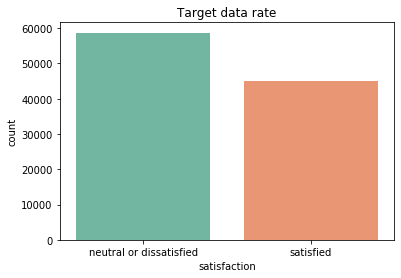

In [ ]:
plt.title('Target data rate')
sns.countplot(x='satisfaction', data=train, palette="Set2");

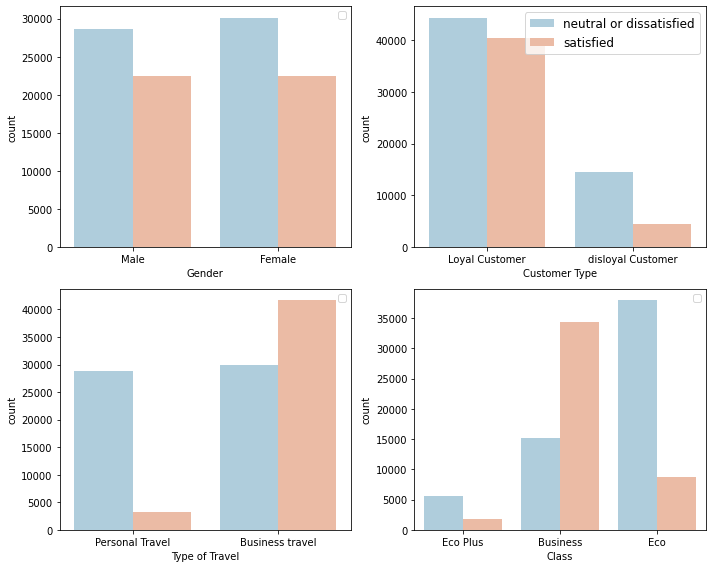

In [ ]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(10, 8))
axs = axs.ravel()

i=0
for col in ['Gender', 'Customer Type', 'Type of Travel', 'Class']:
    
    # define location
    plt.subplot(2, 2, i+1)
    
    # create plot
    ax = plt.gca()
    axs[i] = sns.countplot(x = col, hue = 'satisfaction', data = train, palette='RdBu_r')
    
    # remove legend
    ax.legend('')
    
    i += 1

# add legend
axs[1].legend(loc='upper right', fontsize=12)
plt.tight_layout()
plt.show()

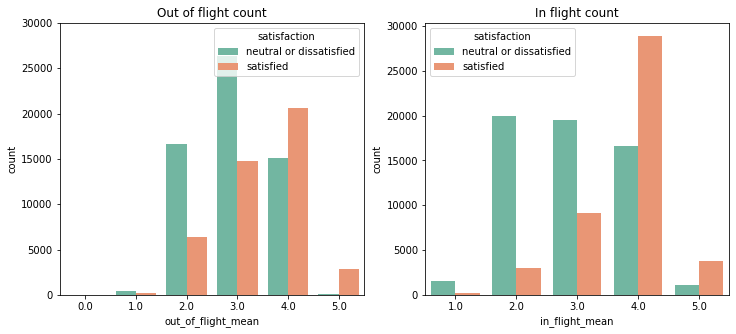

In [ ]:
plt.subplots(nrows=2, ncols=2, figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title('Out of flight count')
plt.ylim(0, 30000)
sns.countplot(x='out_of_flight_mean',hue="satisfaction",data=train, palette="Set2");
plt.subplot(1, 2, 2)
plt.title('In flight count')
sns.countplot(x='in_flight_mean',hue="satisfaction",data=train, palette="Set2", );

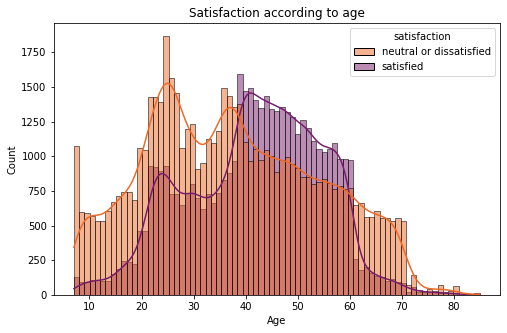

In [ ]:
plt.figure(figsize=(8,5))
plt.title('Satisfaction according to age')
sns.histplot(x='Age', hue="satisfaction", data=train, kde=True, palette="inferno_r");

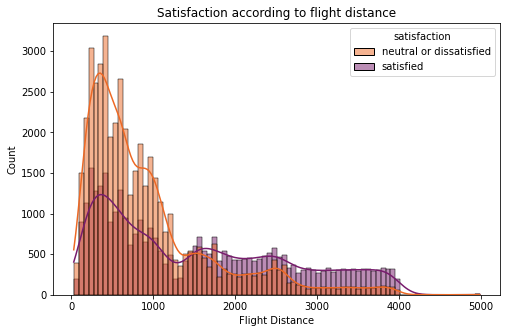

In [ ]:
plt.figure(figsize=(8,5))
plt.title('Satisfaction according to flight distance')
sns.histplot(x='Flight Distance', hue="satisfaction", data=train, kde=True, palette="inferno_r");

#4) 머신러닝 방식 적용 및 교차검증
**baseline과 사용한 모델 성능 비교**

 > baseline Accuracy: 0.566%
  
 >  RandomForest Accuracy : 0.958%
  
 > XGB Accuracy : 0.935%

학습한 모델 모두 baseline보다 높은 수치가 나왔습니다.


RandomForest와 XGBoost중 accuracy, roc_auc점수가 RandomForest가 높지만 둘다 100%에 가까운 수치가 나와

Hyperparameter Tuning경험이 적은 XGBoost모델을 선택하였습니다.

성능 개선을 위한 방법으로 RandomizedSearchCV를 통해 Hyperparameter Tuning과 Cross Validation방법을 이용해 성능을 개선할 것입니다.

**최종 모델의 test score**
>XGB Accuracy : 0.938%


>XGB roc_auc_score : 0.994%





  


Train / validation / test 분리

In [ ]:
# target값 변경 satisfied > 1, neutral or dissatisfied > 0
train["satisfaction"] = train["satisfaction"].map({"satisfied":1,"neutral or dissatisfied":0})
test["satisfaction"] = test["satisfaction"].map({"satisfied":1,"neutral or dissatisfied":0})

In [ ]:
train_val = train.copy()
train, val = train_test_split(train, test_size=0.2, random_state=2)

target = 'satisfaction'
features = train.drop(columns=[target]).columns

X_train_val = train_val[features]
y_train_val = train_val[target]
X_train = train[features]
y_train = train[target]
X_val = val[features]
y_val = val[target]
X_test = test[features]
y_test = test[target]

print('train_val shape:', train_val.shape)
print('X_train shape:', X_train.shape)
print('X_val shape:', X_val.shape)
print('X_train shape:', X_test.shape)

train_val shape: (103594, 26)
X_train shape: (82875, 25)
X_val shape: (20719, 25)
X_train shape: (25893, 25)


In [ ]:
# 기준 모델
major = y_train.mode()
y_pred = [major.iloc[0]] * len(y_train)
baseline = accuracy_score(y_train, y_pred)
print('기준모델 정확도:', baseline)

기준모델 정확도: 0.5664313725490197


In [ ]:
enc = OrdinalEncoder()
enc_X_train_val = enc.fit_transform(X_train_val)
enc_X_train = enc.transform(X_train)
enc_X_val = enc.transform(X_val)
enc_X_test = enc.transform(X_test)

In [ ]:
forest = RandomForestClassifier(n_estimators=100, random_state=2, n_jobs=-1)
forest.fit(enc_X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=2, verbose=0,
                       warm_start=False)

In [ ]:
xgb = xgboost.XGBClassifier(n_estimators=100, random_state=2, n_jobs=-1)
xgb.fit(enc_X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=-1,
              nthread=None, objective='binary:logistic', random_state=2,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [ ]:
print('baseline Accuracy:', baseline)

y_pred_proba = forest.predict_proba(enc_X_val)[:, 1]
print('RandomForest Accuracy:', forest.score(enc_X_val, y_val))
print('RandomForest roc_auc_score:', roc_auc_score(y_val, y_pred_proba))

y_pred_proba = xgb.predict_proba(enc_X_val)[:, 1]
print('XGB Accuracy:', xgb.score(enc_X_val, y_val))
print('XGB roc_auc_score:', roc_auc_score(y_val, y_pred_proba))

baseline Accuracy: 0.5664313725490197
RandomForest Accuracy: 0.9586852647328539
RandomForest roc_auc_score: 0.9927206563326783
XGB Accuracy: 0.9350837395627202
XGB roc_auc_score: 0.9858063673972317


**XGBoost Hyperparameter Tuning**

In [ ]:
clf = xgboost.XGBClassifier(random_state=2, tree_method='gpu_hist', gpu_id=0, predictor='gpu_predictor')

param_grid = {
        'max_depth': [6, 10, 15, 20],
        'learning_rate': [0.001, 0.01, 0.1, 0.2, 0,3],
        'subsample': [0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
        'colsample_bytree': [0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
        'colsample_bylevel': [0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
        'min_child_weight': [0.5, 1.0, 3.0, 5.0, 7.0, 10.0],
        'gamma': [0, 0.25, 0.5, 1.0],
        'reg_lambda': [0.1, 1.0, 5.0, 10.0, 50.0, 100.0],
        'n_estimators': [100]}

eval_set = [(enc_X_train, y_train), 
            (enc_X_val, y_val)]

rs_clf = RandomizedSearchCV(clf, param_grid, n_iter=50,
                            n_jobs=-1, verbose=1, cv=5,
                            scoring='roc_auc', random_state=2)

In [ ]:
rs_clf

RandomizedSearchCV(cv=5, error_score=nan,
                   estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                           colsample_bylevel=1,
                                           colsample_bynode=1,
                                           colsample_bytree=1, gamma=0,
                                           gpu_id=0, learning_rate=0.1,
                                           max_delta_step=0, max_depth=3,
                                           min_child_weight=1, missing=None,
                                           n_estimators=100, n_jobs=1,
                                           nthread=None,
                                           objective='binary:logistic',
                                           predictor='gpu_predictor',
                                           random_...
                                                             0.8, 0.9, 1.0],
                                        'gamma': [0, 0.25,

In [ ]:
import time
print("Randomized search..")
search_time_start = time.time()
rs_clf.fit(enc_X_train, y_train,
           eval_set=eval_set)
print("Randomized search time:", time.time() - search_time_start)

Randomized search..
Fitting 5 folds for each of 50 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:  3.9min
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed: 16.1min
[Parallel(n_jobs=-1)]: Done 250 out of 250 | elapsed: 20.5min finished


[0]	validation_0-error:0.052887	validation_1-error:0.065447
[1]	validation_0-error:0.041098	validation_1-error:0.050726
[2]	validation_0-error:0.035885	validation_1-error:0.046769
[3]	validation_0-error:0.035053	validation_1-error:0.045514
[4]	validation_0-error:0.033967	validation_1-error:0.044452
[5]	validation_0-error:0.033557	validation_1-error:0.045128
[6]	validation_0-error:0.032977	validation_1-error:0.044259
[7]	validation_0-error:0.032748	validation_1-error:0.044452
[8]	validation_0-error:0.032241	validation_1-error:0.044886
[9]	validation_0-error:0.031976	validation_1-error:0.044452
[10]	validation_0-error:0.030866	validation_1-error:0.044452
[11]	validation_0-error:0.030805	validation_1-error:0.043583
[12]	validation_0-error:0.030166	validation_1-error:0.043583
[13]	validation_0-error:0.029997	validation_1-error:0.043294
[14]	validation_0-error:0.029925	validation_1-error:0.043197
[15]	validation_0-error:0.029406	validation_1-error:0.043149
[16]	validation_0-error:0.028778	v

In [ ]:
best_score = rs_clf.best_score_
best_params = rs_clf.best_params_
print("Best score: {}".format(best_score))
print("Best params: ")
for param_name in sorted(best_params.keys()):
    print('%s: %r' % (param_name, best_params[param_name]))

Best score: 0.9946876990123681
Best params: 
colsample_bylevel: 0.5
colsample_bytree: 0.9
gamma: 0
learning_rate: 0.1
max_depth: 15
min_child_weight: 3.0
n_estimators: 100
reg_lambda: 1.0
subsample: 1.0


**최종 XGBoost test 점수**

In [ ]:
# best parameter 적용
args = {'base_score':0.5, 'booster':'gbtree', 'colsample_bylevel':0.5,
              'colsample_bynode':1, 'colsample_bytree':0.9, 'gamma':0,
              'learning_rate':0.1, 'max_delta_step':0, 'max_depth':15,
              'min_child_weight':3.0, 'missing':None, 'n_estimators':100, 'n_jobs':1,
              'nthread':None,'objective':'binary:logistic', 'random_state':2, 'reg_alpha':0,
              'reg_lambda':1.0, 'scale_pos_weight':1, 'seed':None, 'silent':None,
              'subsample':1.0,  'verbosity':1}

model = xgboost.XGBClassifier(**args)
model.fit(enc_X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=0.5,
              colsample_bynode=1, colsample_bytree=0.9, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=15,
              min_child_weight=3.0, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=2,
              reg_alpha=0, reg_lambda=1.0, scale_pos_weight=1, seed=None,
              silent=None, subsample=1.0, verbosity=1)

In [ ]:
print('XGB Accuracy:', xgb.score(enc_X_test, y_test))
y_pred_proba = model.predict_proba(enc_X_test)[:, 1]
print('XGB roc_auc_score:', roc_auc_score(y_test, y_pred_proba))

XGB Accuracy: 0.9387865446259607
XGB roc_auc_score: 0.9948405288281706


In [ ]:
y_test_pred = model.predict(enc_X_test)
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     14528
           1       0.97      0.94      0.96     11365

    accuracy                           0.96     25893
   macro avg       0.96      0.96      0.96     25893
weighted avg       0.96      0.96      0.96     25893



# 5) 머신러닝 모델 해석
모델이 관측치를 예측하기 위해서 어떤 특성을 활용했나요?

어떤 특성이 있다면 모델의 예측에 도움이 될까요? 해당 특성은 어떻게 구할 수 있을까요?



10000개 sample data 개별 관측치가 타겟에 어떻게 영향을 미치는지 보기위한 summary_plot

상위 4개의 특성

1. Inflight wifi service : 값이 크면 타겟에 긍정적인 영향을 끼치지만 작은 값도 
긍정적인 영향을 미친다. (좀 더 분석 필요.)

2. Type of Travel : Personal Travel보다  Business travel이 타겟에 긍정적인 영향을 끼친다.

3. Online boarding : Online boarding의 값이 클 수록  타겟에 긍정적인 영향을 끼친다.

4. Customer Type : Loyal Customer가 disloyal Customer보다 타겟에 긍정적인 영향을 끼친다.


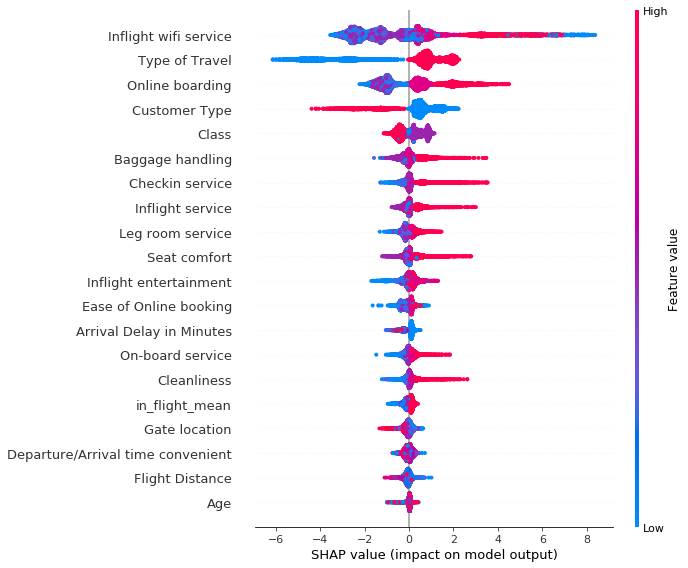

In [ ]:
shap_values = explainer.shap_values(enc_X_test.loc[10000:20000])
shap.summary_plot(shap_values, enc_X_test.loc[10000:20000])

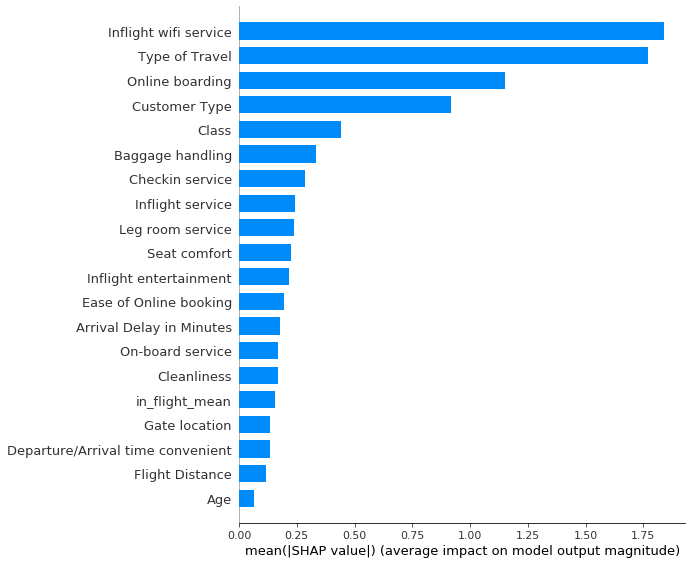

In [ ]:
shap_values = explainer.shap_values(enc_X_test.loc[10000:20000])
shap.summary_plot(shap_values, row, plot_type="bar")

PDP : 어떤 특성이 예측모델의 타겟변수에 어떤 영향을 미칠지 판단

Type of Travel, Customer Type비교

여행사는 Business travel을 떠나는 Loyal Customer에게 더 좋은 서비스를 대접하여 타겟에 긍정적인 영향을 더 끼칠 것이다.

Type of Travel : Personal Travel = 1, Business travel = 2

Customer Type : Loyal Customer = 1, disloyal Customer = 2

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


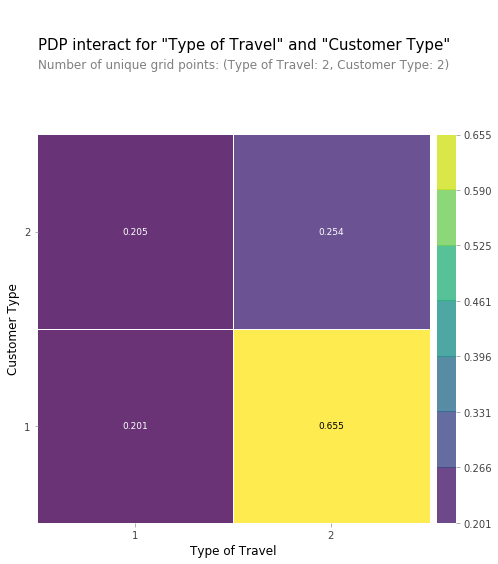

In [ ]:
features = ['Type of Travel', 'Customer Type']

interaction = pdp_interact(
    model=model, 
    dataset=enc_X_train, 
    model_features=enc_X_train.columns, 
    features=features
)

pdp_interact_plot(interaction, plot_type='grid', feature_names=features);

Type of Travel, Age비교

연령별로 성인부터 노년기 전까지의 사람들이 즉, Business여행을 떠나는 직장인들이 설문조사의 높은 점수를 주었다.


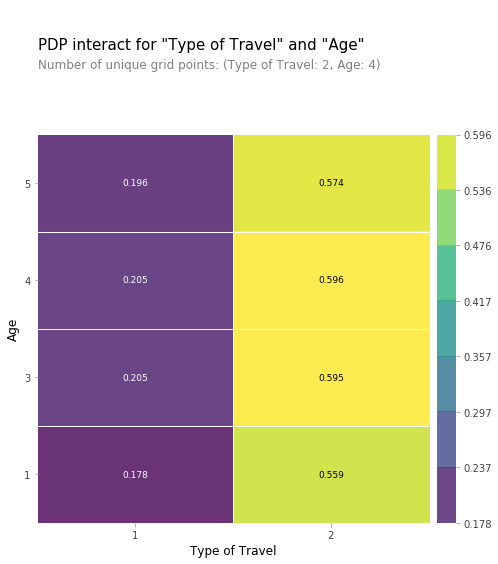

In [ ]:
features = ['Type of Travel', 'Age']

interaction = pdp_interact(
    model=model, 
    dataset=enc_X_train, 
    model_features=enc_X_train.columns, 
    features=features
)

pdp_interact_plot(interaction, plot_type='grid', feature_names=features);

Inflight wifi service, Online boarding비교

Inflight wifi service는 점수가 0, 5일때 타겟에 긍정적인 영향을 끼치는데 짐작해 보면 비행기에 wifi service가 없다면 점수를 0으로 하여 설문항목에서 제외시켜 점수를 종합하지 않았을 것이다. (확실하지 않음) 

Online boarding는 점수가 높다면 타겟에 긍정적인 영향을 끼친다.

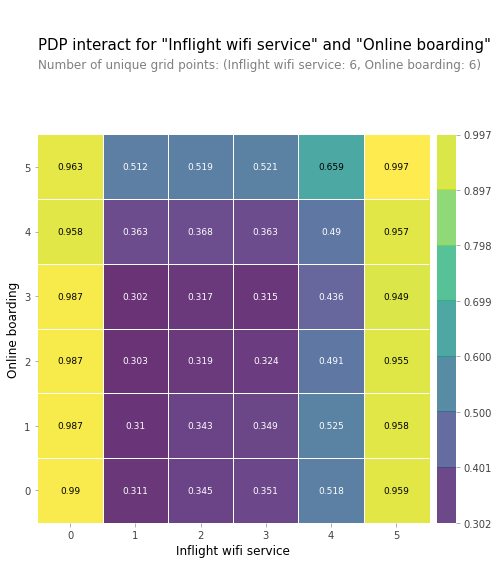

In [ ]:
features = ['Inflight wifi service', 'Online boarding']

interaction = pdp_interact(
    model=model, 
    dataset=enc_X_train, 
    model_features=enc_X_train.columns, 
    features=features
)

pdp_interact_plot(interaction, plot_type='grid', feature_names=features);

Class, Seat comfort비교

Eco Plus = 1

Business = 2

Eco = 3

Class종류에 따라 미세하게 타겟에 긍정적인 영향을 끼친다.

Seat comfort점수가 높을 수록 타겟에 긍정적인 영향을 끼친다.

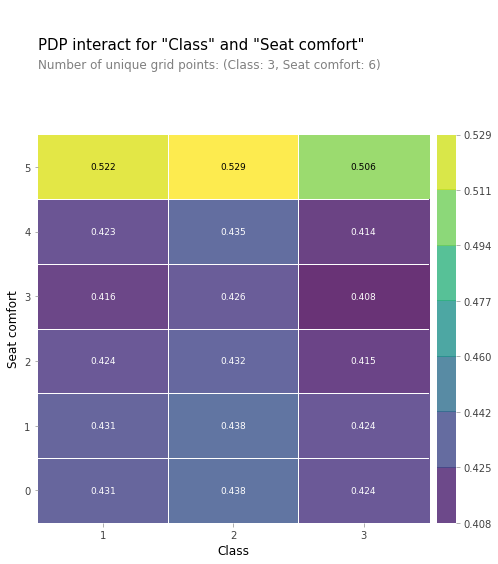

In [ ]:
features = ['Class', 'Seat comfort']

interaction = pdp_interact(
    model=model, 
    dataset=enc_X_train, 
    model_features=enc_X_train.columns, 
    features=features
)

pdp_interact_plot(interaction, plot_type='grid', feature_names=features);

out of flight mean,	in flight mean비교

out of flight mean(비행기 외적 요소)는 타겟에 영향을 끼치지 않는다.

in flight mean(비행기 내적 요소)는 타겟어 긍정적인 영향을 끼친다.

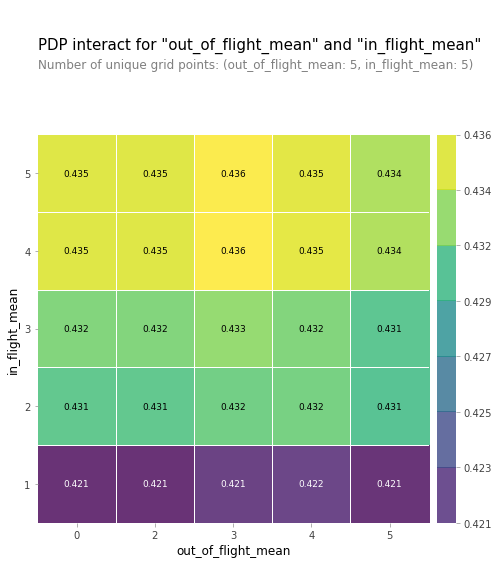

In [ ]:
features = ['out_of_flight_mean',	'in_flight_mean']

interaction = pdp_interact(
    model=model, 
    dataset=enc_X_train, 
    model_features=enc_X_train.columns, 
    features=features
)

pdp_interact_plot(interaction, plot_type='grid', feature_names=features);

SHAP

샘플 데이터 하나를 지정해 어떠한 특성이 타겟에 영향을 끼치는지 관찰

타겟 : 1 (서비스 만족) 샘플

특성 Inflight wifi service, Online boarding이 높은 점수로 티겟에 영향을 끼쳤다.

In [ ]:
row = enc_X_test.loc[1010:1010]
shap_values = explainer.shap_values(row)
shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values,
    features=row
)

타겟 : 1 (서비스 만족) 샘플

특성 Inflight wifi service, Leg room service가 높은 점수로 타겟에 영향을 끼쳤다.

In [ ]:
row = enc_X_test.loc[1001:1001]
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(row)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values,
    features=row
)

타겟 : 0 (서비스 중립, 불만족) 샘플

특성 Inflight wifi service, Online boarding이 낮은 점수이고, 
Customer Type이 disloyal Customer로, 만족도에 부정적인 영향을 끼쳤다.

In [ ]:
row = enc_X_test.loc[1021:1021]
shap_values = explainer.shap_values(row)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values,
    features=row
)

타겟 : 0 (서비스 중립, 불만족) 샘플

특성 Type of Travel, Inflight wifi service, Online boarding이 낮은 점수로 타겟에 영향을 끼쳤다.

In [ ]:
row = enc_X_test.loc[1005:1005]
shap_values = explainer.shap_values(row)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values,
    features=row
)

Permutation Importance

In [ ]:
import eli5
from xgboost import XGBClassifier
from eli5.sklearn import PermutationImportance

permuter = PermutationImportance(
    model, 
    scoring='roc_auc',
    n_iter=5,
    random_state=2
)
permuter.fit(enc_X_test, y_test);

feature_names = enc_X_test.columns.tolist()
pd.Series(permuter.feature_importances_, feature_names).sort_values()

delay_diff                          -0.000014
Gender                               0.000006
out_of_flight_mean                   0.000016
Food and drink                       0.000083
Departure Delay in Minutes           0.000095
Age                                  0.000184
in_flight_mean                       0.000190
Ease of Online booking               0.000296
Departure/Arrival time convenient    0.000359
Flight Distance                      0.000544
Arrival Delay in Minutes             0.000676
Leg room service                     0.000718
Gate location                        0.000755
Inflight entertainment               0.001405
Class                                0.001412
On-board service                     0.002468
Cleanliness                          0.003243
Seat comfort                         0.005018
Inflight service                     0.006037
Checkin service                      0.006353
Baggage handling                     0.008440
Online boarding                   

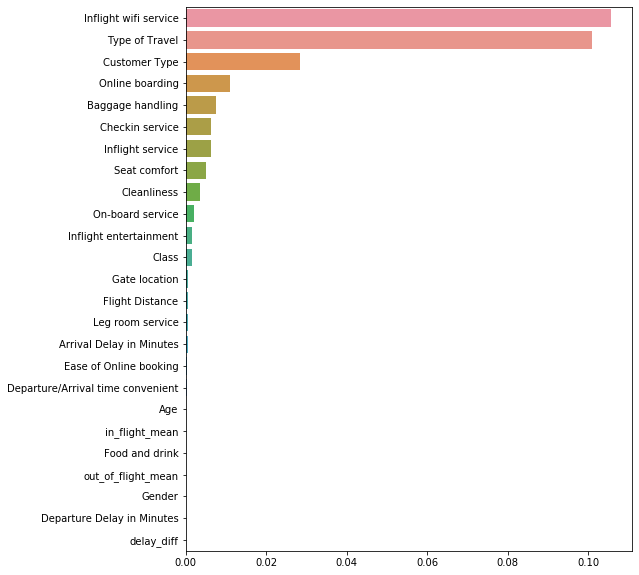

In [ ]:
permuter_series = pd.Series(permuter.feature_importances_, feature_names).sort_values(ascending=False)
plt.figure(figsize=(8,10))
sns.barplot(permuter_series, permuter_series.index);